In [1]:
import matplotlib.pyplot as plt
%matplotlib inline
import matplotlib_inline
matplotlib_inline.backend_inline.set_matplotlib_formats('svg')
import seaborn as sns
sns.set_context("paper")
sns.set_style("ticks")

# Uncomment the next two lines if running for the book
# import warnings
# warnings.filterwarnings("ignore")

from functools import partial
import jax
from jax import vmap, jit, grad, value_and_grad
import jax.numpy as jnp
import jax.random as jrandom
import gpjax as gpx
import optax
from jax.scipy.optimize import minimize
import scipy.stats.qmc as qmc
import numpy as np

jax.config.update("jax_enable_x64", True)
np.random.seed(0)
key = jrandom.PRNGKey(np.random.randint(0, 10000))

# Uncertainty Sampling Example

We will do uncertainty sampling (i.e., active learning with the expected information gain objective) to create the best model with the least amount of data.

## 1D example

Here is the data-generating process. (Yes, it's just a simple python function. But pretend it's something much more expensive to evaluate, like a physical experiment or a complex simulation.)

In [2]:
def data_generating_process_1d(x, key):
    """Stand-in for a real data-generating process."""
    return jnp.sin(10*x**2) + x + 0.1*jrandom.normal(key)

Start with just one data point:

In [3]:
X_1d = jrandom.uniform(key, (1, 1))
y_1d = vmap(data_generating_process_1d)(X_1d, jrandom.split(key, X_1d.shape[0]))

Let's train a Gaussian process surrogate on the data.
Note that we assume the measurement noise is known and fix it to be $\sigma=0.1.$

In [4]:
def train_gp(X, y, posterior=None, measurement_noise=None, key=None, verbose=False):
    D = gpx.Dataset(X, y)
    negative_mll = lambda p, d: -gpx.objectives.conjugate_mll(p, d)

    if posterior is None:
        mean = gpx.mean_functions.Constant()
        kernel = gpx.kernels.RBF(lengthscale=jnp.ones(X.shape[1]), variance=1.0)
        prior = gpx.gps.Prior(mean_function=mean, kernel=kernel)
        likelihood = gpx.likelihoods.Gaussian(
            num_datapoints=D.n
        )
        posterior = prior * likelihood

        # On GPJax version 0.9.2, static (non-trainable) parameters in the likelihood must be set after
        # the posterior object is created. When the posterior object is created, any static parameters are
        # overrided to be trainable parameters, and the `fit` function tries to optimize them.
        if measurement_noise is not None:
            posterior.likelihood.obs_stddev = gpx.parameters.Static(measurement_noise)
        
        posterior, _ = gpx.fit(
            model=posterior,
            objective=negative_mll,
            train_data=D,
            optim=optax.adam(1e-3),
            num_iters=2000,
            key=key,
            verbose=verbose
        )
    else:
        posterior, _ = gpx.fit_scipy(
            model=posterior,
            objective=negative_mll,
            train_data=D,
            verbose=verbose
        )
    return posterior

def eval_gp(X_pred, X_train, y_train, posterior):
    D = gpx.Dataset(X_train, y_train)
    latent_dist = posterior.predict(X_pred, train_data=D)
    return latent_dist.mean(), latent_dist.stddev()

def predict(X_pred, X_train, y_train, posterior):
    D = gpx.Dataset(X_train, y_train)
    latent_dist = posterior.predict(X_pred, train_data=D)
    predictive_dist = posterior.likelihood.predict(latent_dist)
    return predictive_dist.mean(), predictive_dist.stddev()

def posterior_uncertainty(x, X, y, posterior):
    """Returns the posterior uncertainty at x."""
    _, s = eval_gp(x[None, :], X, y, posterior)
    return s.squeeze()

In [5]:
sigma_1d = 0.1

key, key_train = jrandom.split(key)
posterior_1d = train_gp(X_1d, y_1d, measurement_noise=sigma_1d, key=key_train)

And let's visualize the uncertainty in the model's prediction:

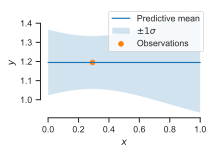

In [6]:
def plot_posterior_uncertainty_1d(posterior, X, y, ax=None, legend=True):
    X_pred = jnp.linspace(0, 1, 100)[:, None]
    mean, std = predict(X_pred, X, y, posterior)
    if ax is None:
        fig, ax = plt.subplots(figsize=(3, 2))
    ax.plot(X_pred, mean, label="Predictive mean" if legend else None)
    ax.fill_between(X_pred.squeeze(), mean - std, mean + std, alpha=0.2, label=r"$\pm 1\sigma$" if legend else None)
    ax.scatter(X, y, label="Observations" if legend else None)
    if legend:
        ax.legend(loc='upper right')
    ax.set_xlabel(r"$x$")
    ax.set_ylabel(r"$y$")
    sns.despine(trim=True)
    return ax

plot_posterior_uncertainty_1d(posterior_1d, X_1d, y_1d);

Uncertainty is lower near the data point and high everywhere else.
Let's find the "best" next point to evaluate. In this case, that is the point where there is maximum posterior uncertainty.

In [7]:
def get_next_x(X, y, posterior, n_start=100):
    """Gets the next optimal x to evaluate.
    
    Uses BFGS from several random starting points to minimize the posterior uncertainty.
    """
    def objective(x_unconstrained):
        """Objective function for maximizing posterior uncertainty."""
        x = jax.nn.sigmoid(x_unconstrained)  # Constrains inputs to [0, 1]
        return -posterior_uncertainty(x, X, y, posterior)
    jitted_minimize = jit(partial(minimize, objective, method="BFGS"))

    X_random_start = qmc.LatinHypercube(X.shape[1]).random(n=n_start)
    X_random_start_unconstrained = vmap(jax.scipy.special.logit)(X_random_start)  # Map points to unconstrained space.
    
    x_opts = []
    f_opts = []
    for x0_unconstrained in X_random_start_unconstrained:
        res = jitted_minimize(x0_unconstrained)
        f_opts.append(res.fun)
        x_opts.append(res.x)
    next_x = jax.nn.sigmoid(x_opts[jnp.argmin(jnp.array(f_opts))])  # Select the best point and map to original space.
    return next_x

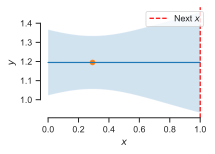

In [8]:
next_x = get_next_x(X_1d, y_1d, posterior_1d)
ax = plot_posterior_uncertainty_1d(posterior_1d, X_1d, y_1d, legend=False)
ax.axvline(next_x, color="red", linestyle="--", label=r"Next $x$")
ax.legend(loc='upper right');

The "best" point is right at the boundary. Let's generate a data value at this point and plot a new fitted GP:

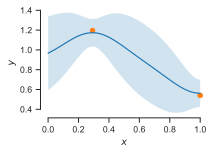

In [9]:
key, key_data, key_train = jrandom.split(key, 3)
next_y = data_generating_process_1d(next_x, key_data)
X_1d = jnp.concatenate([X_1d, next_x[None, :]], axis=0)
y_1d = jnp.concatenate([y_1d, next_y[None]], axis=0)
posterior_1d = train_gp(X_1d, y_1d, measurement_noise=sigma_1d, key=key_train)
ax = plot_posterior_uncertainty_1d(posterior_1d, X_1d, y_1d, legend=False)

Let's repeat this process a few more times:

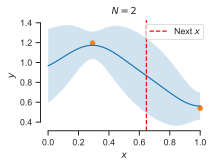

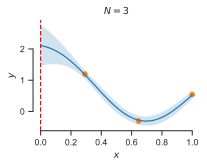

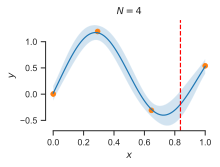

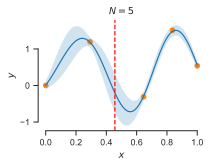

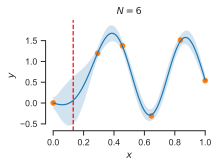

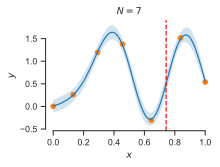

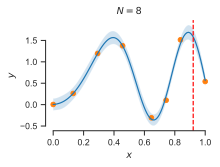

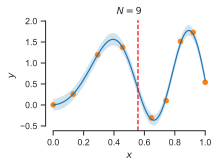

In [10]:
for i in range(8):
    next_x = get_next_x(X_1d, y_1d, posterior_1d)
    ax = plot_posterior_uncertainty_1d(posterior_1d, X_1d, y_1d, legend=False)
    ax.axvline(next_x, color="red", linestyle="--", label=r"Next $x$")
    ax.set_title(f"$N={X_1d.shape[0]}$")
    if i == 0:
        ax.legend(loc='upper right')
    key, key_data, key_train = jrandom.split(key, 3)
    next_y = data_generating_process_1d(next_x, key_data)
    X_1d = jnp.concatenate([X_1d, next_x[None, :]], axis=0)
    y_1d = jnp.concatenate([y_1d, next_y[None]], axis=0)
    posterior_1d = train_gp(X_1d, y_1d, measurement_noise=sigma_1d, key=key_train)

In a realistic scenario, we would keep going until the epistemic uncertainty is low enough or we run out of computational budget.

## 2D example

Let's do the same thing in 2D. The data-generating process is:

In [11]:
@jit
def data_generating_process_2d(x):
    x1, x2 = x[0], x[1]
    f1 = 1/2*jnp.sin(5/2*x1 + 2/3*x2)**2 + 2/3*jnp.exp(-x1*(x2 - 0.5)**2)*jnp.cos(4*x1 + x2)**2
    f2 = x1*(1 - x1)*x2*(1 - x2)*10
    alpha = jax.nn.sigmoid(10*(x2 - x1))
    return jnp.atleast_1d(alpha*f1 + (1 - alpha)*f2)

Again, pretend `data_generating_process_2d` is actually some expensive process. 

Let's start with a few data points:

In [12]:
X_2d = qmc.LatinHypercube(d=2).random(n=5)
y_2d = vmap(data_generating_process_2d)(X_2d)

Fit a GP:

In [13]:
sigma_2d = 1e-3  # Low measurement noise because the data generating process is noiseless.

key, key_train = jrandom.split(key)
posterior_2d = train_gp(X_2d, y_2d, measurement_noise=sigma_2d, key=key_train)

Find the best next point at which to collect data:

In [14]:
next_x = get_next_x(X_2d, y_2d, posterior_2d)

And plot:

In [15]:
def plot_posterior_uncertainty_2d(X, y, posterior, unc_clim=None):
    X1_plt, X2_plt = jnp.meshgrid(jnp.linspace(0, 1, 50), jnp.linspace(0, 1, 50))
    X_plt = jnp.stack([X1_plt.ravel(), X2_plt.ravel()], axis=1)
    
    fig, ax = plt.subplots(1, 3, figsize=(9, 3), sharex=True, sharey=True)

    # Ground truth
    Y_gt_plt = vmap(data_generating_process_2d)(X_plt).reshape(X1_plt.shape)
    p = ax[0].pcolormesh(X1_plt, X2_plt, Y_gt_plt, cmap="viridis")
    p.set_edgecolor('face')
    ax[0].set_aspect("equal")
    ax[0].set_title("Ground truth", fontsize=12)

    # Predictive mean
    mean, _ = partial(predict, X_train=X, y_train=y, posterior=posterior)(X_plt)
    Y_pred_plt = mean.reshape(X1_plt.shape)
    p = ax[1].pcolormesh(X1_plt, X2_plt, Y_pred_plt, cmap="viridis", vmin=p.get_clim()[0], vmax=p.get_clim()[1])
    p.set_edgecolor('face')
    ax[1].scatter(X[:,0], X[:,1], color="C1", label="Observation")
    ax[1].set_aspect("equal")
    ax[1].set_title("Posterior mean", fontsize=12)

    # Posterior uncertainty
    jitted_posterior_uncertainty = jit(partial(posterior_uncertainty, X=X, y=y, posterior=posterior))
    Y_unc_plt = vmap(jitted_posterior_uncertainty)(X_plt).reshape(X1_plt.shape)
    p = ax[2].pcolormesh(X1_plt, X2_plt, Y_unc_plt, cmap="viridis", vmin=unc_clim[0] if unc_clim is not None else None, vmax=unc_clim[1] if unc_clim is not None else None)
    p.set_edgecolor('face')
    ax[2].scatter(X[:,0], X[:,1], color="C1", label="Observation")
    ax[2].set_aspect("equal")
    ax[2].set_xticks([0, 0.5, 1])
    ax[2].set_yticks([0, 0.5, 1])
    ax[2].set_title("Posterior uncertainty", fontsize=12)

    sns.despine(trim=True, left=True, bottom=True)
    return ax, p.get_clim()

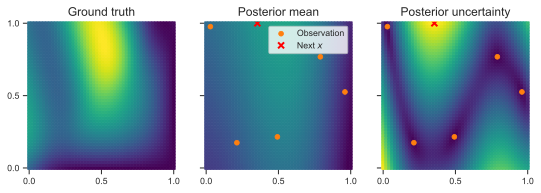

In [16]:
ax, unc_clim = plot_posterior_uncertainty_2d(X_2d, y_2d, posterior_2d)
ax[1].plot(next_x[0], next_x[1], "rx", ms=6, mew=2, label="Next $x$")
ax[2].plot(next_x[0], next_x[1], "rx", ms=6, mew=2, label="Next $x$")
ax[1].legend(loc='upper right');

The highest uncertainty is at the edge of the domain, so that is where the next best point is.

Let's do a few more iterations of active learning:

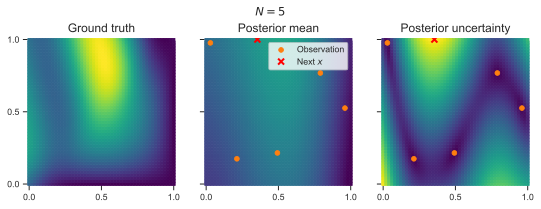

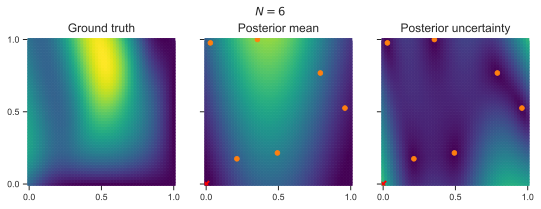

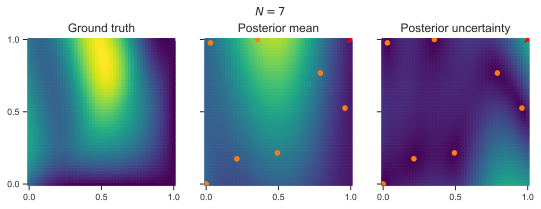

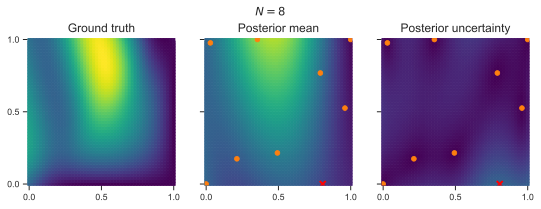

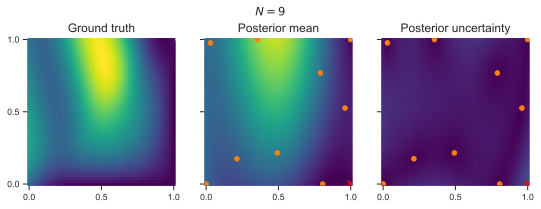

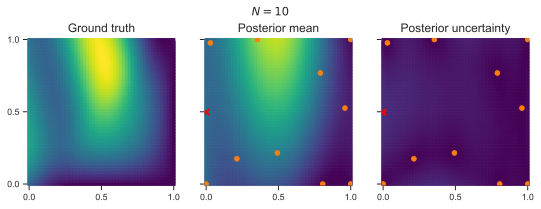

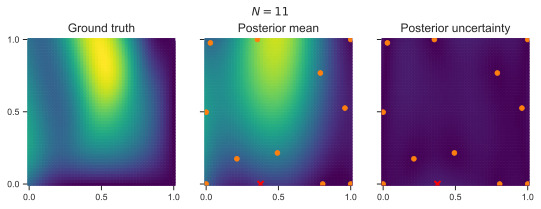

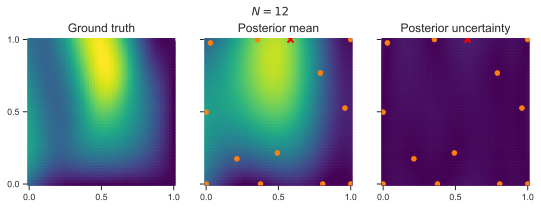

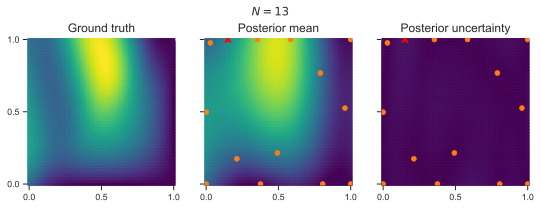

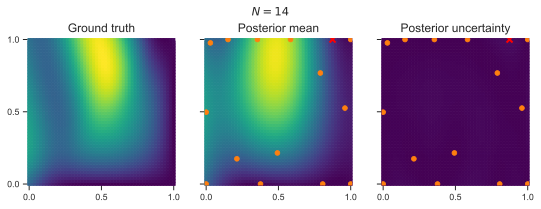

In [17]:
for i in range(10):
    next_x = get_next_x(X_2d, y_2d, posterior_2d)
    ax, _ = plot_posterior_uncertainty_2d(X_2d, y_2d, posterior_2d, unc_clim=unc_clim)
    ax[1].plot(next_x[0], next_x[1], "rx", ms=6, mew=2, label="Next $x$")
    ax[2].plot(next_x[0], next_x[1], "rx", ms=6, mew=2, label="Next $x$")
    ax[0].get_figure().suptitle(f"$N={X_2d.shape[0]}$")
    if i == 0:
        ax[1].legend(loc='upper right')   
    key, key_data, key_train = jrandom.split(key, 3)
    next_y = data_generating_process_2d(next_x)
    X_2d = jnp.concatenate([X_2d, next_x[None, :]], axis=0)
    y_2d = jnp.concatenate([y_2d, next_y[:, None]], axis=0)
    posterior_1d = train_gp(X_2d, y_2d, measurement_noise=sigma_2d, key=key_train)

We have created a model in an optimally efficient manner (in terms of reducing epistemic uncertainty).

Again, most of the new points are at the boundary. 
This will be even truer in higher dimensions.
If that is not desirable, then we may need a different information acquisition function (i.e., one that reflects the fact that we value reducing uncertainty in the middle of the domain more than at the edges).